<center><h1>DeepGlobe Road Extraction - Error Analysis</h1></center>

## 1. `import`  Packages

In [1]:
! pip install patool --quiet

In [2]:
import os
import patoolib
import pandas as pd
import cv2 as cv
import numpy as np
import tensorflow as tf

from sklearn.model_selection import train_test_split
from skimage.filters import threshold_otsu
from matplotlib import pyplot as plt
from tensorflow.keras.layers import (
    Input,
    Conv2D,
    MaxPooling2D,
    concatenate,
    Conv2DTranspose,
    BatchNormalization,
    Dropout,
    Activation,
    Concatenate
)
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import (
    EarlyStopping,
    ModelCheckpoint
)

## 2. Load Data

In [3]:
project_path = '/content/drive/MyDrive/AAIC/SCS-2/deep_globe_road_extraction/'

In [4]:
# patoolib.extract_archive(archive=project_path + 'zip_files/DeepGlobe_256.zip', outdir='/content/DeepGlobe')

In [5]:
file_path = '/content/DeepGlobe/metadata.csv'
df = pd.read_csv(filepath_or_buffer=file_path)

In [6]:
train_data = df[df['split'] == 'train']
valid_data = df[df['split'] == 'valid']
test_data = df[df['split'] == 'test']

Selecting a sample data

In [7]:
sample_data = train_data.sample(frac=0.1, random_state=42)
sample_data = sample_data[:100]

In [8]:
sample_data.shape

(100, 4)

## 3. U-NET Model

Reference → https://youtu.be/GAYJ81M58y8

<center><img src="https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/u-net-architecture.png"></center>

In [9]:
## Reference → https://youtu.be/GAYJ81M58y8
## The below code is taken from the above video link. Although I have modified it.
## I give full credit to the author of the video and the creators of UNet.

class UNET:
    # convolution block
    def _convolve(self, input_, filters):
        x = Conv2D(filters=filters, kernel_size=(3, 3), kernel_initializer='he_normal', padding='same')(input_)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        
        x = Conv2D(filters=filters, kernel_size=(3, 3), kernel_initializer='he_normal', padding='same')(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        
        return x
    
    # up-sampling and convolotion block
    def _convolve_by_upsampling(self, input_, skip_connector, filters, rate):
        x = Conv2DTranspose(filters=filters, kernel_size=(3, 3), strides=(2, 2), padding='same')(input_)
        x = concatenate([x, skip_connector])
        x = Dropout(rate)(x)
        x = self._convolve(input_=x, filters=filters)
        return x
    
    # UNET main model 
    def unet_main(self, input_, filters=16, rate=0.05):
        # left encoder Path
        c1 = self._convolve(input_=input_, filters=filters)
        p1 = MaxPooling2D(pool_size=(2, 2))(c1)
        p1 = Dropout(rate)(p1)
        
        c2 = self._convolve(input_=p1, filters=filters * 2)
        p2 = MaxPooling2D(pool_size=(2, 2))(c2)
        p2 = Dropout(rate)(p2)
        
        c3 = self._convolve(input_=p2, filters=filters * 4)
        p3 = MaxPooling2D(pool_size=(2, 2))(c3)
        p3 = Dropout(rate)(p3)
        
        c4 = self._convolve(input_=p3, filters=filters * 8)
        p4 = MaxPooling2D(pool_size=(2, 2))(c4)
        p4 = Dropout(rate)(p4)

        # middle bridge
        c5 = self._convolve(input_=p4, filters=filters * 16)
        
        # right decoder path
        c6 = self._convolve_by_upsampling(input_=c5, skip_connector=c4, filters=filters * 8, rate=rate)
        c7 = self._convolve_by_upsampling(input_=c6, skip_connector=c3, filters=filters * 4, rate=rate)
        c8 = self._convolve_by_upsampling(input_=c7, skip_connector=c2, filters=filters * 2, rate=rate)
        c9 = self._convolve_by_upsampling(input_=c8, skip_connector=c1, filters=filters * 1, rate=rate)
        
        output_ = Conv2D(filters=1, kernel_size=(1, 1), activation='sigmoid')(c9)
        
        model = Model(inputs=[input_], outputs=[output_])
        
        return model

## 4. IoU Score

<center><img src="https://pyimagesearch.com/wp-content/uploads/2016/09/iou_equation.png"></center>

**Credits** - pyimagesearch.com

### 4.1. U-NET IoU Score

In [10]:
def analyze_unet_iou_score(x, model):
    # paths of images
    images_fps   = x['sat_image_path'].to_list()
    # paths of masked images
    masks_fps    = x['mask_path'].to_list()

    images_scores = {}
    for oimg, mimg in zip(images_fps, masks_fps):
        # original image
        simage = plt.imread('/content/DeepGlobe/' + oimg)
        # original mask
        smask = plt.imread('/content/DeepGlobe/' + mimg)
        smask = smask[:,:,0]

        # prediction
        predicted_image  = model.predict(simage[np.newaxis,:,:,:])
        predicted_mask = predicted_image.reshape(simage.shape[0], simage.shape[1])
        # automatic threshold identification
        pmask_thresh = threshold_otsu(predicted_mask)
        # binarizing the mask
        th, predicted_mask = cv.threshold(src=predicted_mask, thresh=pmask_thresh, maxval=255, type=cv.THRESH_BINARY)
        
        bin_thresh = 128
        mask_thresh = predicted_mask > bin_thresh
        union = np.logical_or(smask, mask_thresh)
        intersection = np.logical_and(smask, mask_thresh)
        iou_score = np.sum(intersection) / np.sum(union)
        images_scores[(oimg, mimg)] = iou_score
    
    scores = list(images_scores.values())
    return images_scores, np.mean(scores)

### 4.2. Basemodel IoU Score

In [11]:
def analyze_basemodel_iou_score(x, model):
    # paths of images
    images_fps   = x['sat_image_path'].to_list()
    # paths of masked images
    masks_fps    = x['mask_path'].to_list()

    images_scores = {}
    for oimg, mimg in zip(images_fps, masks_fps):
        # original image
        simage = cv.imread('/content/DeepGlobe/' + oimg, cv.IMREAD_UNCHANGED)
        simage = cv.cvtColor(simage, cv.COLOR_BGR2RGB)

        # origna mask
        smask = cv.imread('/content/DeepGlobe/' + mimg, cv.IMREAD_UNCHANGED)
        smask = smask[:,:,0]

        # prediction
        predicted_image  = model.predict(simage[np.newaxis,:,:,:])
        predicted_mask = tf.argmax(predicted_image, axis=-1)
        predicted_mask = np.array(predicted_mask[0])
        predicted_mask = np.where((predicted_mask == 1), 255, 0)

        bin_thresh = 128
        mask_thresh = predicted_mask > bin_thresh
        union = np.logical_or(smask, mask_thresh)
        intersection = np.logical_and(smask, mask_thresh)
        iou_score = np.sum(intersection) / np.sum(union)
        images_scores[(oimg, mimg)] = iou_score
    
    scores = list(images_scores.values())
    return images_scores, np.mean(scores)

### 4.3. Best Medium Worst

#### 4.3.1. U-NET (BMW)

In [12]:
def display_patterns_unet(data_list, model, n=5):
    if not data_list:
        print('No data available.')
        return None
    
    images = [i[0] for i in data_list[:n]]
    masks = [i[1] for i in data_list[:n]]
    
    for oimg, mimg in zip(images, masks):
        # original image
        simage = cv.imread('/content/DeepGlobe/' + oimg, cv.IMREAD_UNCHANGED)
        simage = cv.cvtColor(simage, cv.COLOR_BGR2RGB)

        # origna mask
        smask = cv.imread('/content/DeepGlobe/' + mimg, cv.IMREAD_UNCHANGED)
        smask = smask[:,:,0]

        # prediction
        predicted_image  = model.predict(simage[np.newaxis,:,:,:])
        predicted_mask = predicted_image.reshape(simage.shape[0], simage.shape[1])
        # automatic threshold identification
        pmask_thresh = threshold_otsu(predicted_mask)
        # binarizing the mask
        th, predicted_mask = cv.threshold(src=predicted_mask, thresh=pmask_thresh, maxval=255, type=cv.THRESH_BINARY)

        # titles
        image_title = oimg.split('/')[-1]
        mask_title = mimg.split('/')[-1]
        
        # plotting figure
        plt.figure(figsize=(15, 6))
        
        plt.subplot(131)
        plt.axis("off")
        plt.title(image_title)
        plt.imshow(simage)

        plt.subplot(132)
        plt.axis("off")
        plt.title(mask_title)
        plt.imshow(smask, cmap='gray')

        plt.subplot(133)
        plt.axis("off")
        plt.title("Prediction - {}".format(image_title))
        plt.imshow(predicted_mask, cmap='gray')
        
        plt.show()

    return None

#### 4.3.2. Basemodels (BMW)

In [13]:
def display_patterns_basemodel(data_list, model, n=5):
    if not data_list:
        print('No data available.')
        return None
    
    images = [i[0] for i in data_list[:n]]
    masks = [i[1] for i in data_list[:n]]
    
    for oimg, mimg in zip(images, masks):
        # original image
        simage = cv.imread('/content/DeepGlobe/' + oimg, cv.IMREAD_UNCHANGED)
        simage = cv.cvtColor(simage, cv.COLOR_BGR2RGB)

        # origna mask
        smask = cv.imread('/content/DeepGlobe/' + mimg, cv.IMREAD_UNCHANGED)
        smask = smask[:,:,0]
        
        # prediction
        predicted_image  = model.predict(simage[np.newaxis,:,:,:])
        predicted_mask = tf.argmax(predicted_image, axis=-1)
        predicted_mask = np.array(predicted_mask[0])
        predicted_mask = np.where((predicted_mask == 1), 255, 0)

        # titles
        image_title = oimg.split('/')[-1]
        mask_title = mimg.split('/')[-1]
        
        # plotting figure
        plt.figure(figsize=(15, 6))
        
        plt.subplot(131)
        plt.axis("off")
        plt.title(image_title)
        plt.imshow(simage)

        plt.subplot(132)
        plt.axis("off")
        plt.title(mask_title)
        plt.imshow(smask, cmap='gray')

        plt.subplot(133)
        plt.axis("off")
        plt.title("Prediction - {}".format(image_title))
        plt.imshow(predicted_mask, cmap='gray')
        
        plt.show()

    return None

#### 4.3.3. Segregation

In [14]:
def segregate_by_iou(sm_data_dictionary):
    # best thresh → (IoU >= 0.5)
    # medium thresh → (IoU >= 0.25) or (IoU < 0.5)
    # worst thresh → (IoU < 0.25)

    best = []
    medium = []
    worst = []

    for (t, i) in sm_data_dictionary.items():
        if (i >= 0.5):
            best.append(t)
        elif (i >= 0.25) or (i < 0.5):
            medium.append(t)
        else:
            worst.append(t)
    
    return best, medium, worst

## 5. Load U-NET Model

In [15]:
def get_unet_model(model_name):
    u = UNET()
    inputs = Input(shape=(256, 256, 3))
    model = u.unet_main(input_=inputs)
    model.compile(optimizer='Adam', loss='binary_crossentropy', metrics=['accuracy'])

    model_path = project_path + 'models/{}.h5'.format(model_name)
    if not os.path.isfile(path=model_path):
        print('Please train the model first.')
    else:
        model.load_weights(model_path)
    
    return model

### 5.1. U-NET IoU Score

#### 5.1.1. No Augmentation

In [16]:
unet_scratch_name = 'unet_scratch'
unet_noaug_model = get_unet_model(model_name=unet_scratch_name)
unet_noaug_sm, unet_noaug_iou = analyze_unet_iou_score(x=sample_data, model=unet_noaug_model)

In [17]:
print('The IoU for the sample data is : {}'.format(unet_noaug_iou))

The IoU for the sample data is : 0.5126380687564733


Data segregation

In [18]:
us_best, us_medium, us_worst = segregate_by_iou(unet_noaug_sm)

Best images - patterns

* We can observe that the prediction and original mask are of exact match.
* In fact, in some cases the prediction masks contain the extact road path than of original masks given.
* These are the images that have high `IoU` scores.

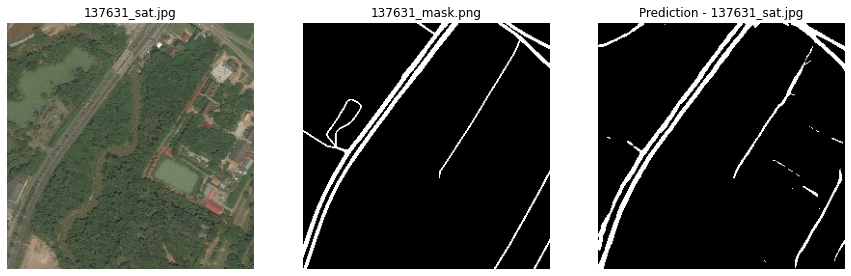

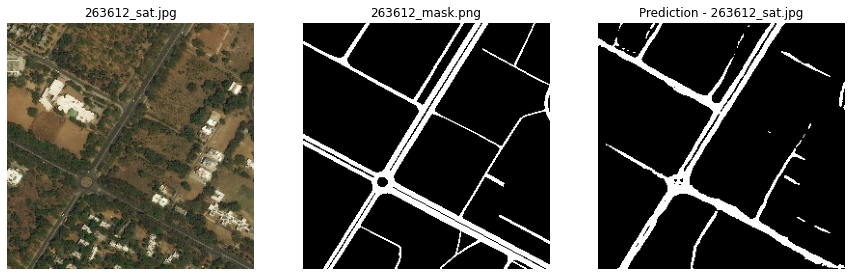

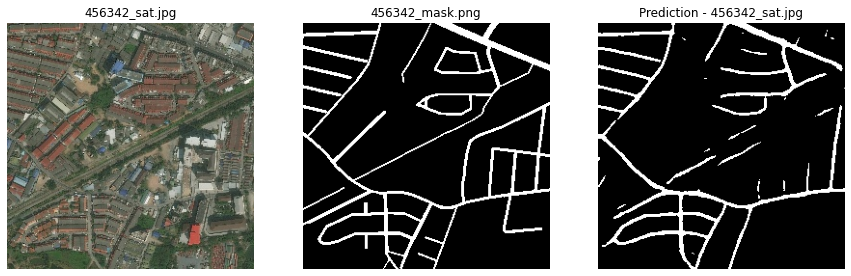

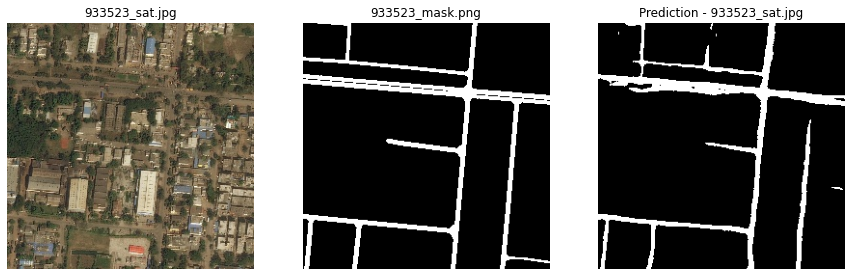

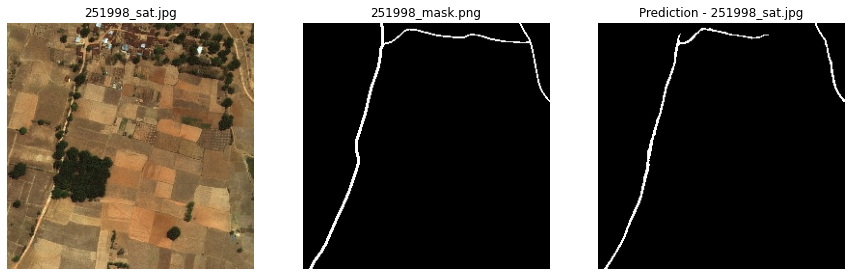

In [19]:
display_patterns_unet(data_list=us_best, model=unet_noaug_model)

Medium images - patterns

* These are the images whose `IoU` are in the range of `0.25` to `0.5`.
* For images that contain complex textures, the model tried its best (there can be further improvement) to extract the paths.
* In some cases, the model extract the tiny paths which is not there in the original mask.

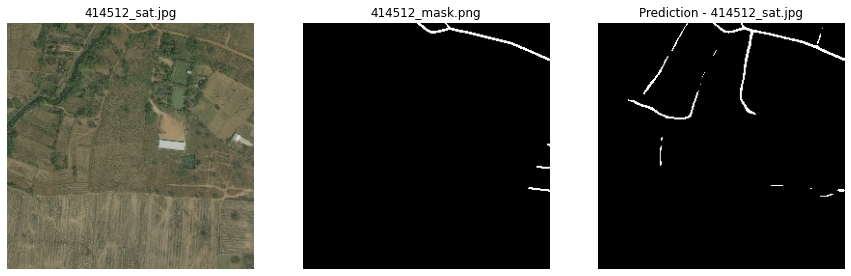

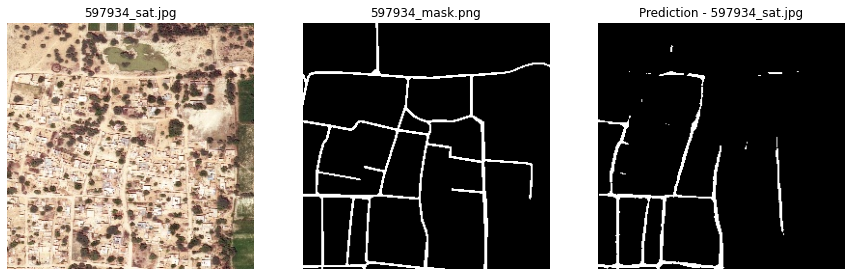

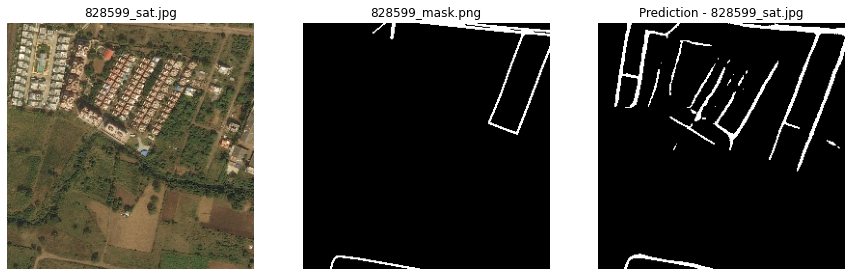

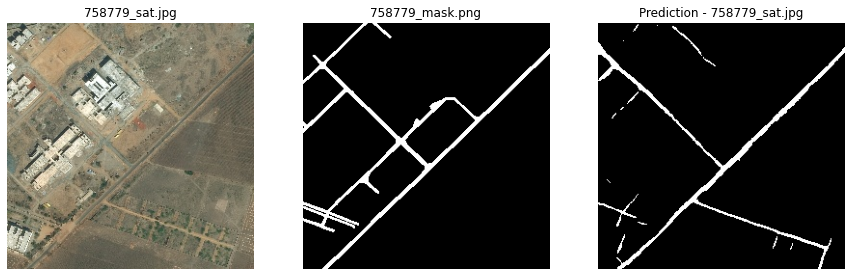

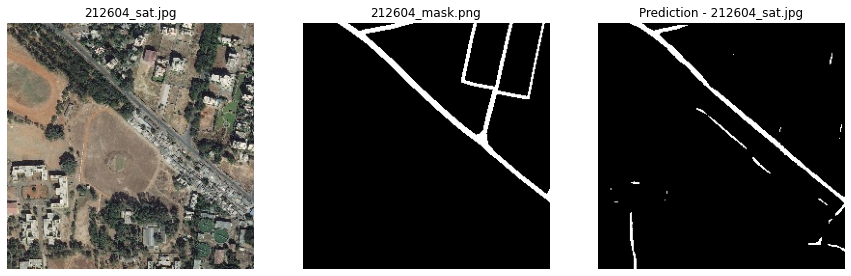

In [20]:
display_patterns_unet(data_list=us_medium, model=unet_noaug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [21]:
display_patterns_unet(data_list=us_worst, model=unet_noaug_model)

No data available.


#### 5.1.2. Augmentation

In [22]:
unet_scratch_aug_name = 'unet_scratch_augmentated'
unet_aug_model = get_unet_model(model_name=unet_scratch_aug_name)
unet_aug_sm, unet_aug_iou = analyze_unet_iou_score(x=sample_data, model=unet_aug_model)

In [23]:
print('The IoU for the sample data is : {}'.format(unet_aug_iou))

The IoU for the sample data is : 0.4827022636638445


Data segregation

In [24]:
usa_best, usa_medium, usa_worst = segregate_by_iou(unet_aug_sm)

Best images - patterns

* In the case of augmented data, the model still performed well. But not as best as non-augmented data.

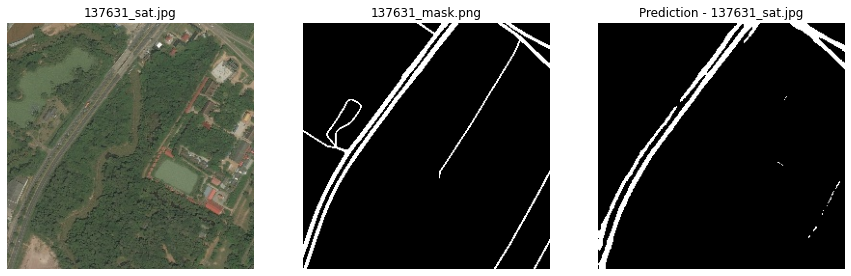

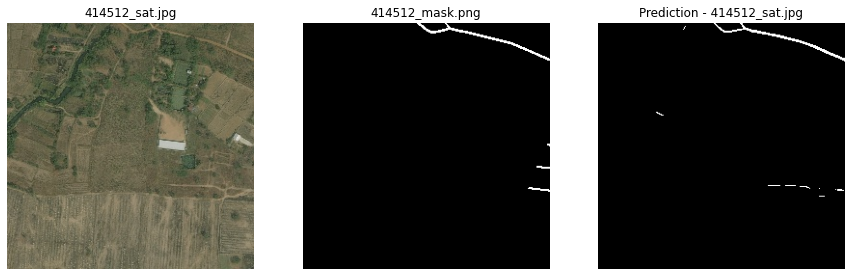

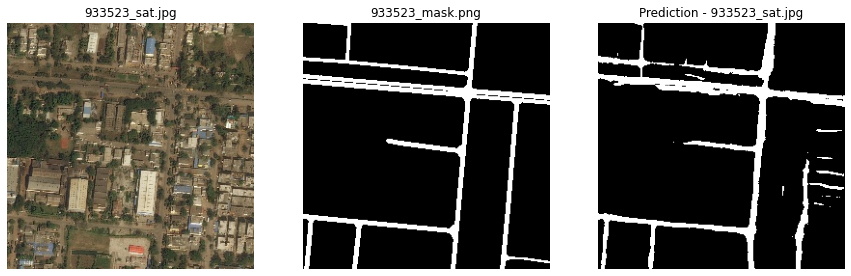

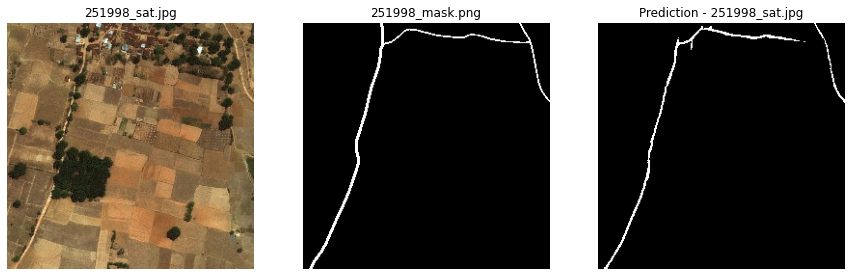

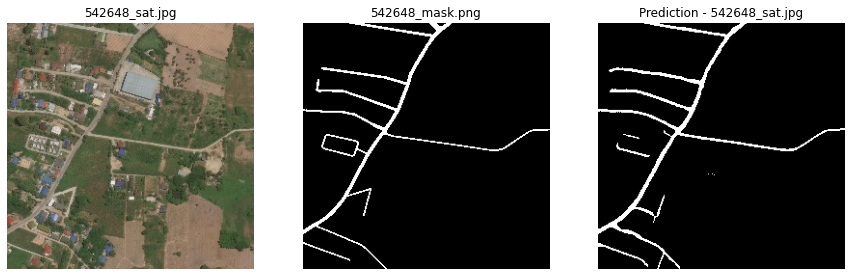

In [25]:
display_patterns_unet(data_list=usa_best, model=unet_aug_model)

Medium images - patterns

* There are quite similar images that were found in the previous case.
* Images with complex textures are hard to predict (path extraction).

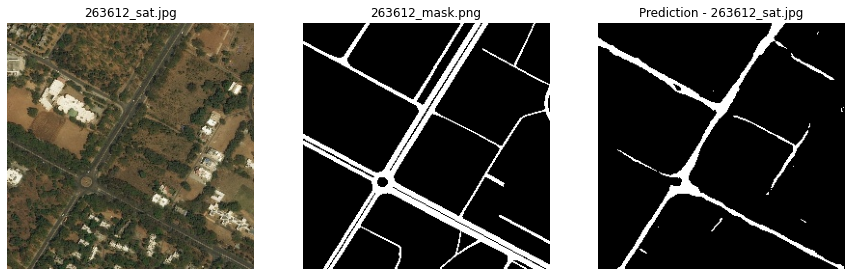

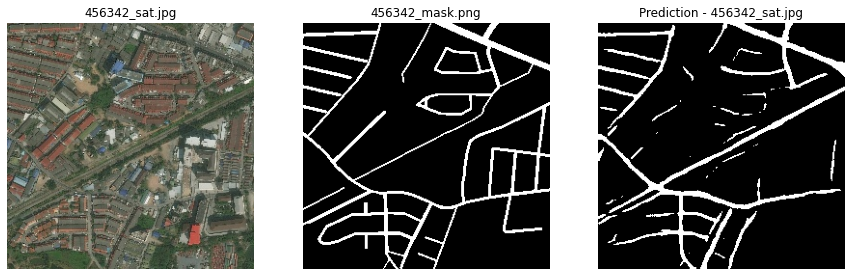

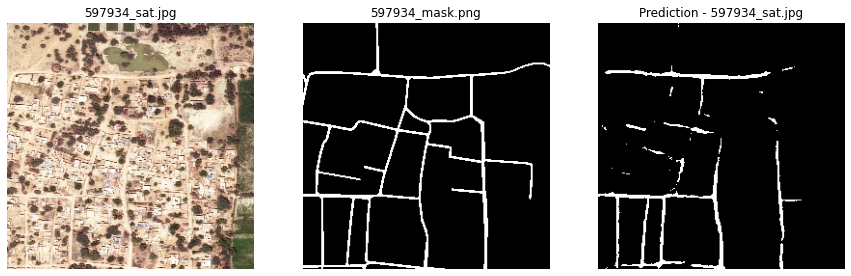

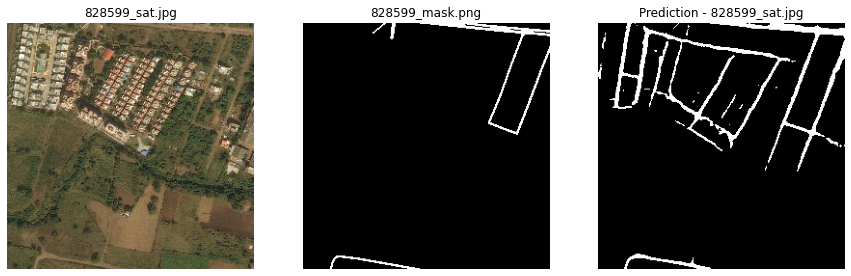

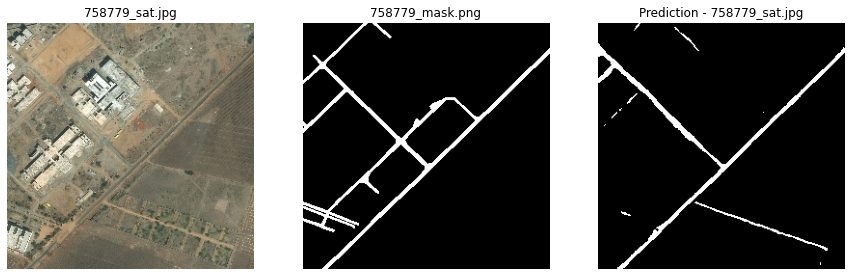

In [26]:
display_patterns_unet(data_list=usa_medium, model=unet_aug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [27]:
display_patterns_unet(data_list=usa_worst, model=unet_aug_model)

No data available.


## 6. Load Basemodel

In [28]:
! pip install -U segmentation-models==0.2.1 --quiet
! pip install tensorflow==2.2.0 --quiet
! pip install keras==2.3.1 --quiet

In [29]:
import warnings
warnings.filterwarnings('ignore')

import tensorflow as tf
import segmentation_models as sm

from tensorflow.keras.models import Model
from segmentation_models import Unet
from segmentation_models.metrics import iou_score

# sm.set_framework('tf.keras')
tf.keras.backend.set_image_data_format('channels_last')

# os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

Using TensorFlow backend.


In [30]:
def get_basemodel(model_name):
    if '_' in model_name:
        model_path = project_path + 'models/{}.h5'.format(model_name)
        model_name = model_name.split('_')[0]
    else:
        model_path = project_path + 'models/{}.h5'.format(model_name)
        model_name = model_name
    
    model = Unet(
        backbone_name=model_name, 
        encoder_weights='imagenet', 
        classes=2, 
        activation='softmax', 
        input_shape=(256, 256, 3), 
        encoder_freeze=True
    )

    optimizer = tf.keras.optimizers.Adam(0.001)
    # cce_dice_loss = categorical_crossentropy + dice_loss
    focal_loss = sm.losses.cce_dice_loss
    model.compile(optimizer=optimizer, loss=focal_loss, metrics=[iou_score])
    
    if not os.path.isfile(path=model_path):
        print('Please train the model first.')
    else:
        model.load_weights(model_path)
    
    return model

### 6.1. ResNet34 IoU Score

#### 6.1.1. No Augmentation

In [31]:
resnet34_name = 'resnet34'
resnet34_noaug_model = get_basemodel(model_name=resnet34_name)
resnet34_noaug_sm, resnet34_noaug_iou = analyze_basemodel_iou_score(x=sample_data, model=resnet34_noaug_model)

In [32]:
print('The IoU for the sample data is : {}'.format(resnet34_noaug_iou))

The IoU for the sample data is : 0.3444520995332658


Data segregation

In [33]:
r34_best, r34_medium, r34_worst = segregate_by_iou(resnet34_noaug_sm)

Best images - patterns

* Images that contain larger paths, model can easily find the path of that. But for thinner paths, it is not doing its best.
* There are some patterns of the predictions that exactly match with original mask.
* With some tweaks in the learning rate or extra epochs, it can be fixed.

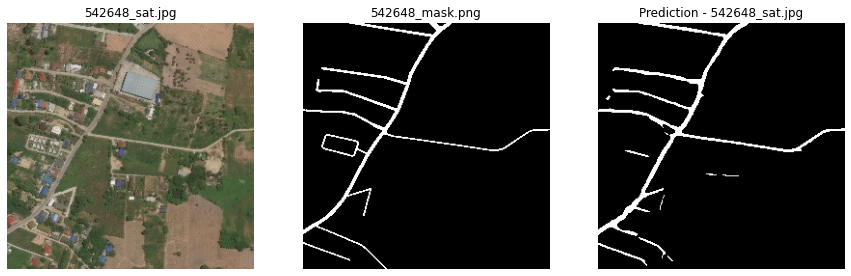

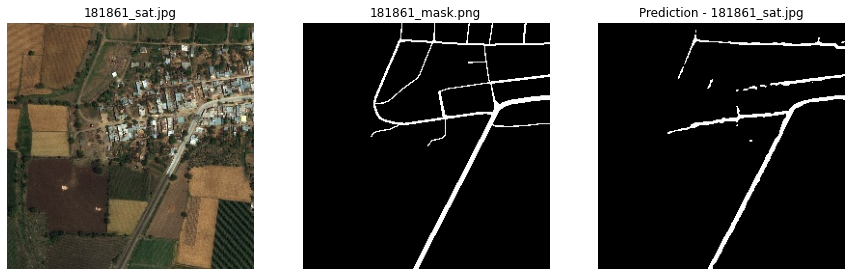

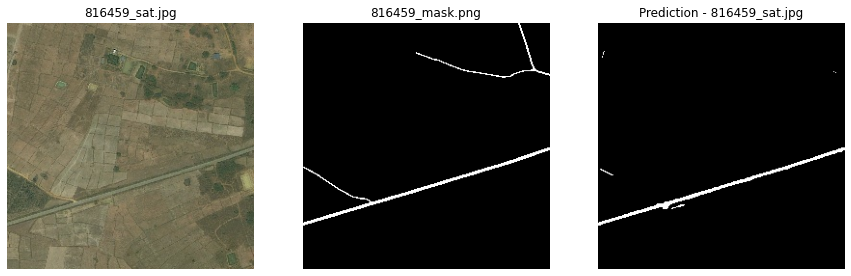

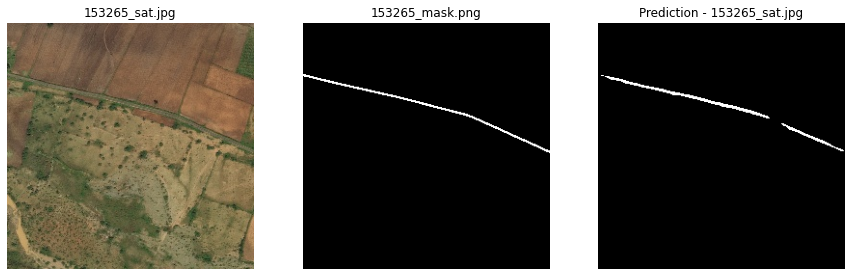

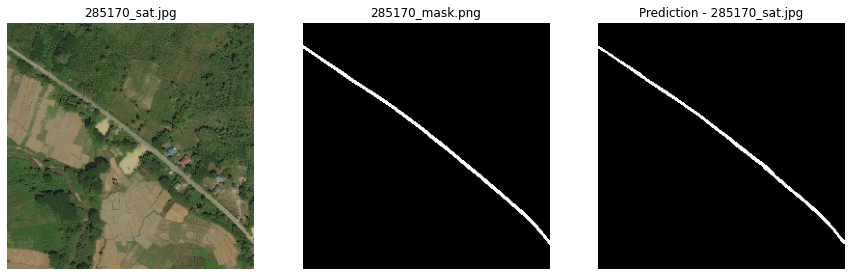

In [34]:
display_patterns_basemodel(data_list=r34_best, model=resnet34_noaug_model)

Medium images - pattern

* In the case of medium images, the model extracted the imcomplete paths.
* The paths that contain large number of bushes on the either side, the model could do extract or do its job well.
* Bushes that are completely levelled up do add value in the whole learning process.

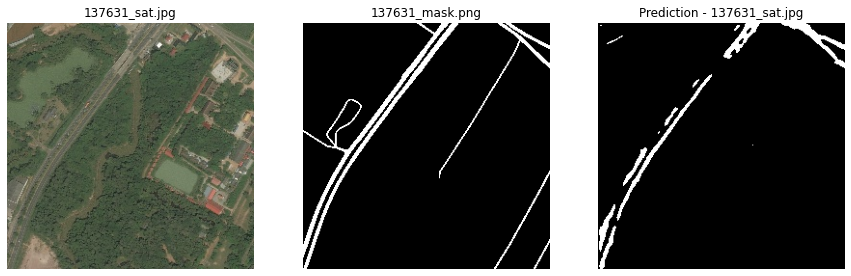

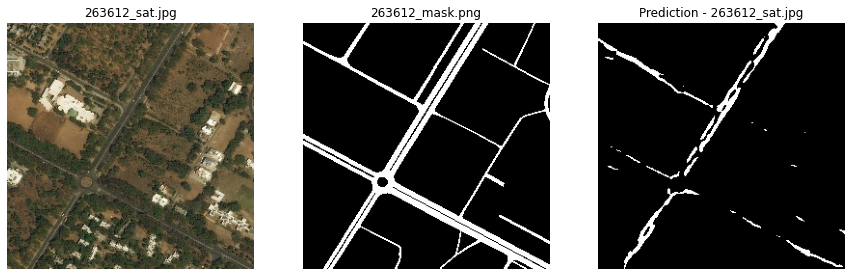

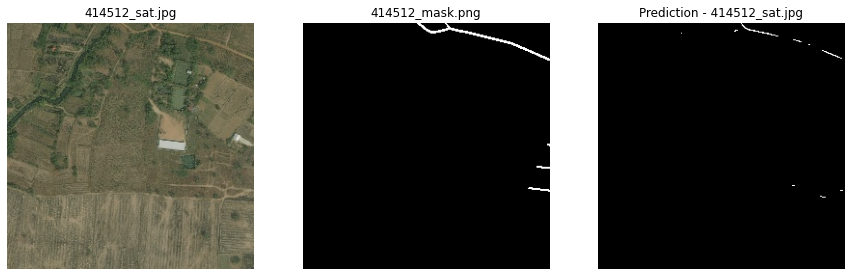

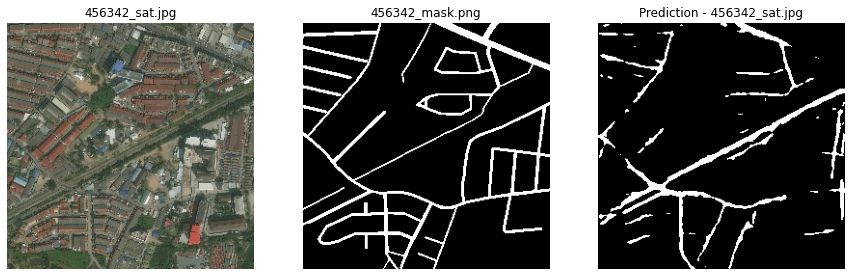

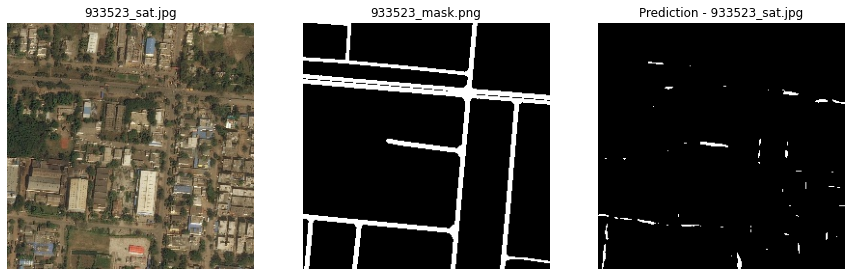

In [35]:
display_patterns_basemodel(data_list=r34_medium, model=resnet34_noaug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [36]:
display_patterns_basemodel(data_list=r34_worst, model=resnet34_noaug_model)

No data available.


#### 6.1.2. Augmentation

In [37]:
resnet34_aug_name = 'resnet34_augmentated'
resnet34_aug_model = get_basemodel(model_name=resnet34_aug_name)
resnet34_aug_sm, resnet34_aug_iou = analyze_basemodel_iou_score(x=sample_data, model=resnet34_aug_model)

In [38]:
print('The IoU for the sample data is : {}'.format(resnet34_aug_iou))

The IoU for the sample data is : 0.08570293180126916


Data segregation

In [39]:
r34a_best, r34a_medium, r34a_worst = segregate_by_iou(resnet34_aug_sm)

Best images - patterns

* In the case of augmented data, the model performed well on those images that contain single larger paths.

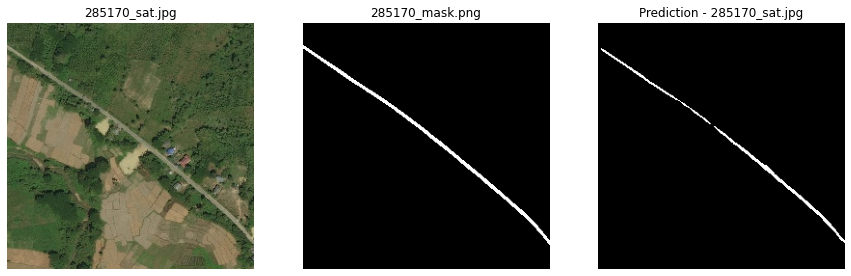

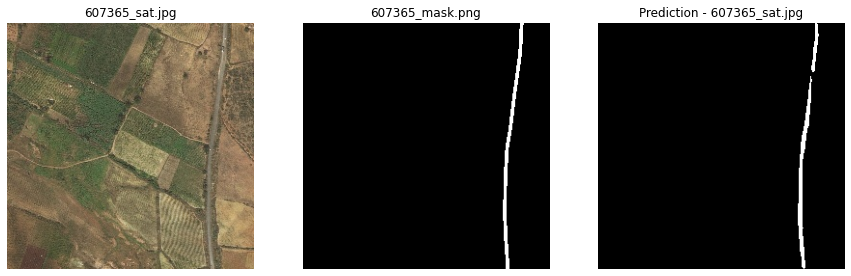

In [40]:
display_patterns_basemodel(data_list=r34a_best, model=resnet34_aug_model)

Medium images - pattern

* Images that contain complex textures are not been predicted by the model at its best.
* Less augmentation operations needs to considered to improve it further.

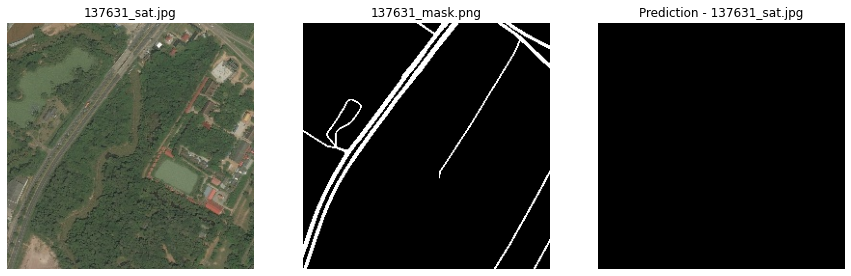

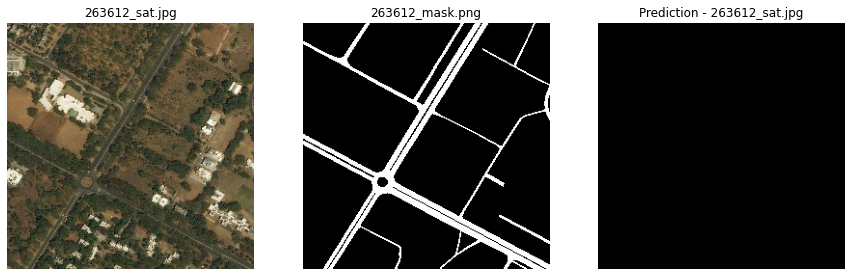

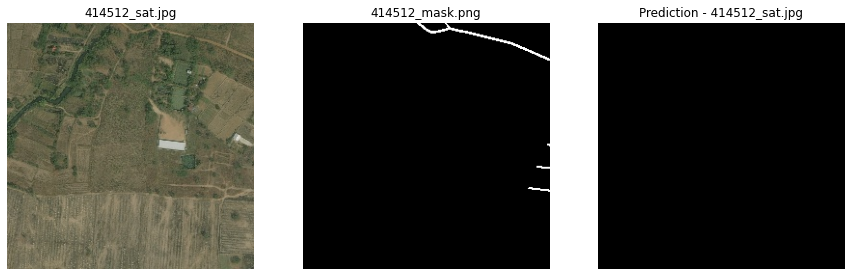

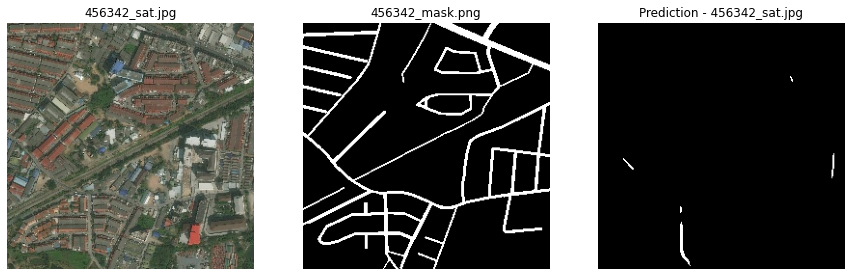

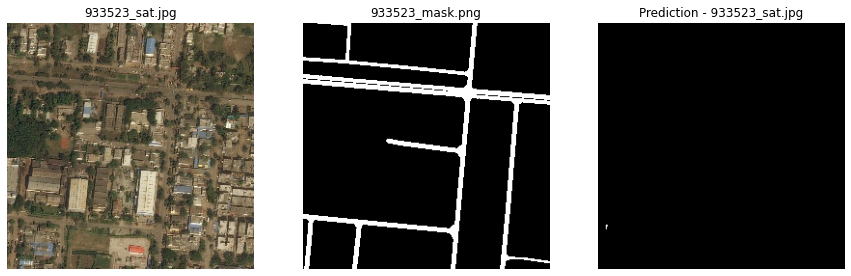

In [41]:
display_patterns_basemodel(data_list=r34a_medium, model=resnet34_aug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [42]:
display_patterns_basemodel(data_list=r34a_worst, model=resnet34_aug_model)

No data available.


### 6.2. VGG16 IoU Score

#### 6.2.1. No Augmentation

In [43]:
vgg16_name = 'vgg16'
vgg16_noaug_model = get_basemodel(model_name=vgg16_name)
vgg16_noaug_sm, vgg16_noaug_iou = analyze_basemodel_iou_score(x=sample_data, model=vgg16_noaug_model)

In [44]:
print('The IoU for the sample data is : {}'.format(vgg16_noaug_iou))

The IoU for the sample data is : 0.3692056147480751


Data segregation

In [45]:
v16_best, v16_medium, v16_worst = segregate_by_iou(vgg16_noaug_sm)

Best images - patterns

* Images that contain larger paths, model can easily find the path of that. But for thinner paths, it is not doing its best.
* There are some patterns of the predictions that exactly match with original mask.
* With some tweaks in the learning rate or extra epochs, it can be fixed.

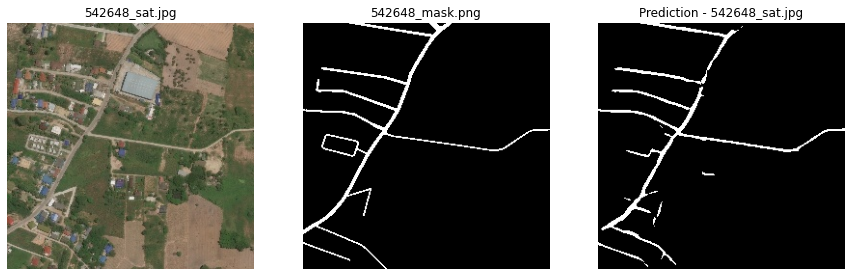

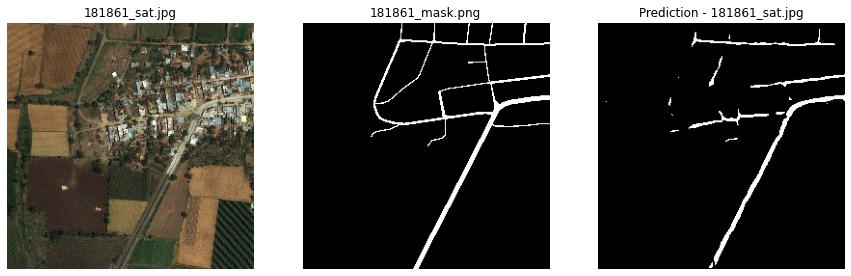

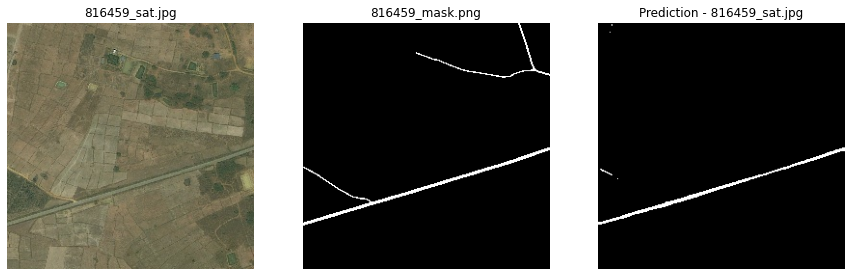

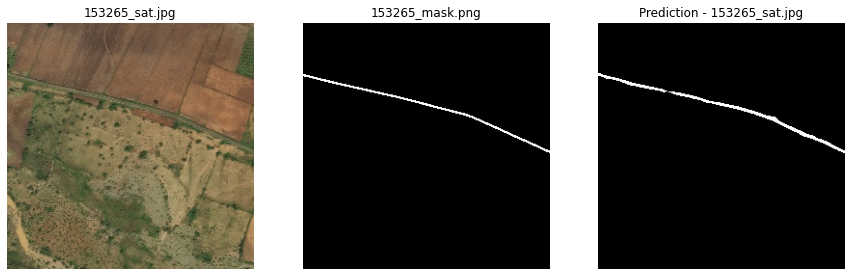

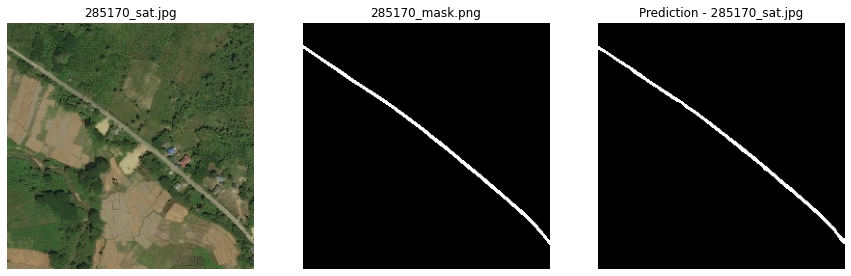

In [46]:
display_patterns_basemodel(data_list=v16_best, model=vgg16_noaug_model)

Medium images - pattern

* In the case of medium images, the model extracted the imcomplete paths.
* The paths that contain large number of bushes on the either side, the model could do extract or do its job well.
* Bushes that are completely levelled up do add value in the whole learning process.

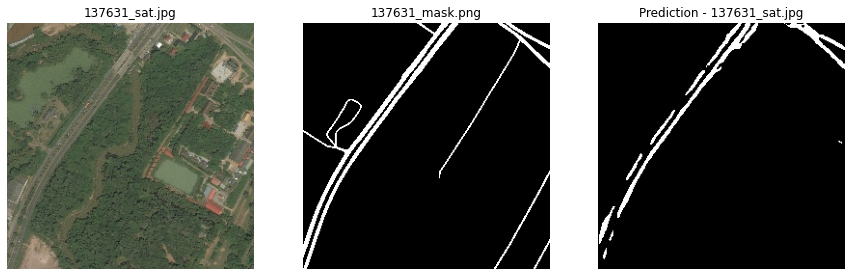

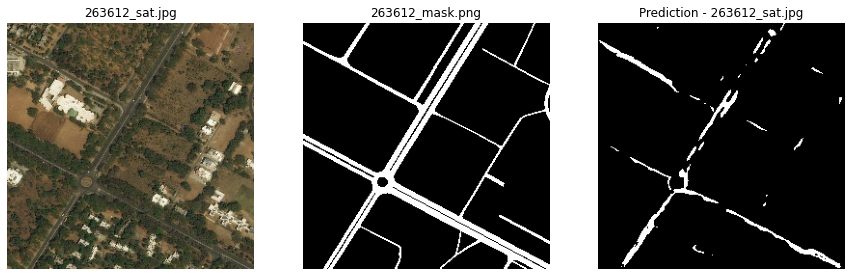

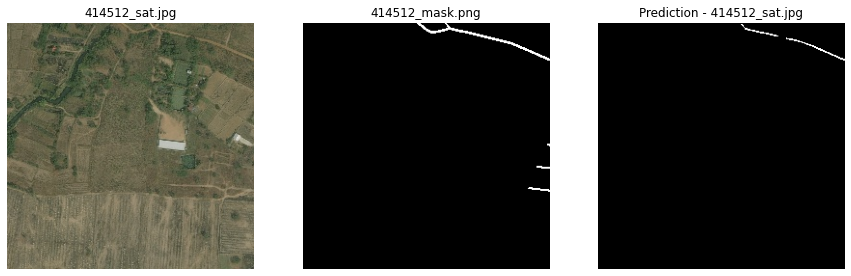

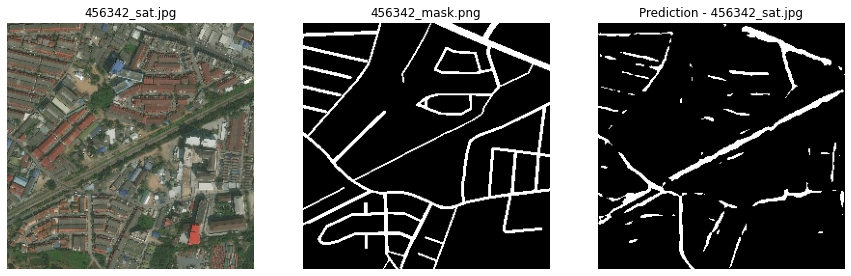

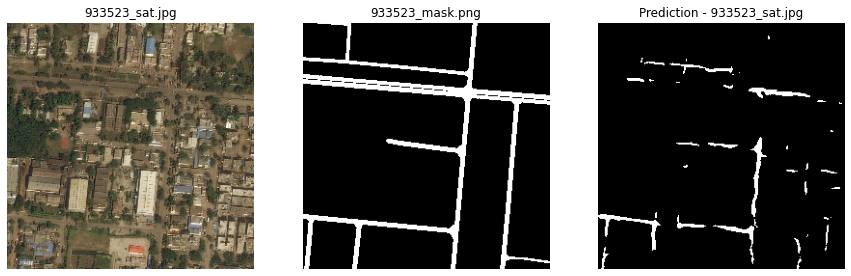

In [47]:
display_patterns_basemodel(data_list=v16_medium, model=vgg16_noaug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [48]:
display_patterns_basemodel(data_list=v16_worst, model=vgg16_noaug_model)

No data available.


#### 6.2.2. Augmentation

In [49]:
vgg16_aug_name = 'vgg16_augmentated'
vgg16_aug_model = get_basemodel(model_name=vgg16_aug_name)
vgg16_aug_sm, vgg16_aug_iou = analyze_basemodel_iou_score(x=sample_data, model=vgg16_aug_model)

In [50]:
print('The IoU for the sample data is : {}'.format(vgg16_aug_iou))

The IoU for the sample data is : 0.05214346490478153


Data segregation

In [51]:
v16a_best, v16a_medium, v16a_worst = segregate_by_iou(vgg16_aug_sm)

Best images - patterns

* In the case of augmented data, the model performed well on those images that contain single larger paths.

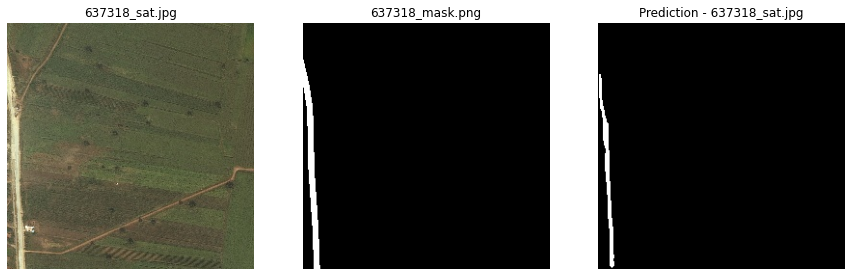

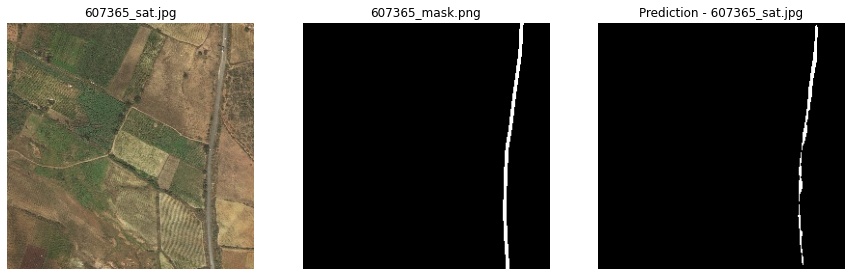

In [52]:
display_patterns_basemodel(data_list=v16a_best, model=vgg16_aug_model)

Medium images - pattern

* Images that contain complex textures are not been predicted by the model at its best.
* Less augmentation operations needs to considered to improve it further.

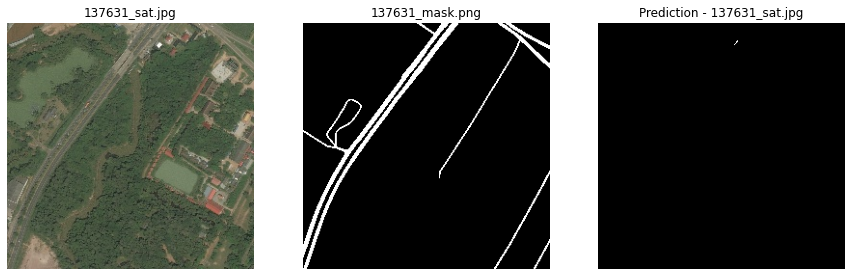

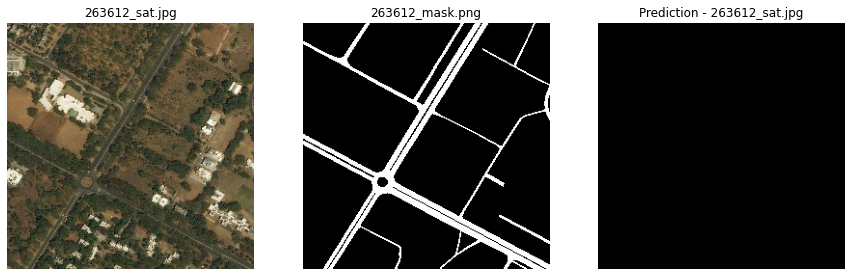

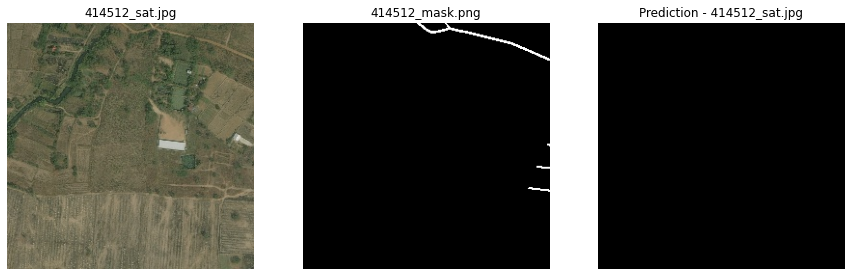

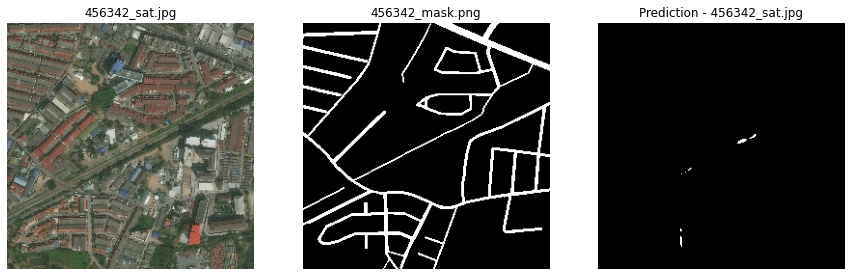

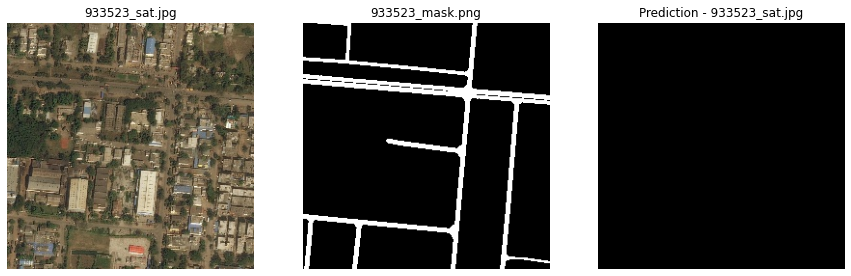

In [53]:
display_patterns_basemodel(data_list=v16a_medium, model=vgg16_aug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [54]:
display_patterns_basemodel(data_list=v16a_worst, model=vgg16_aug_model)

No data available.


### 6.3. MobileNet IoU Score

#### 6.3.1. No Augmentation

In [55]:
mobnet_name = 'mobilenetv2'
mobnet_noaug_model = get_basemodel(model_name=mobnet_name)
mobnet_noaug_sm, mobnet_noaug_iou = analyze_basemodel_iou_score(x=sample_data, model=mobnet_noaug_model)

In [56]:
print('The IoU for the sample data is : {}'.format(mobnet_noaug_iou))

The IoU for the sample data is : 0.37807135483731125


Data segregation

In [57]:
mob_best, mob_medium, mob_worst = segregate_by_iou(mobnet_noaug_sm)

Best images - patterns

* Images that contain larger paths, model can easily find the path of that. But for thinner paths, it is not doing its best.
* There are some patterns of the predictions that exactly match with original mask.
* With some tweaks in the learning rate or extra epochs, it can be fixed.

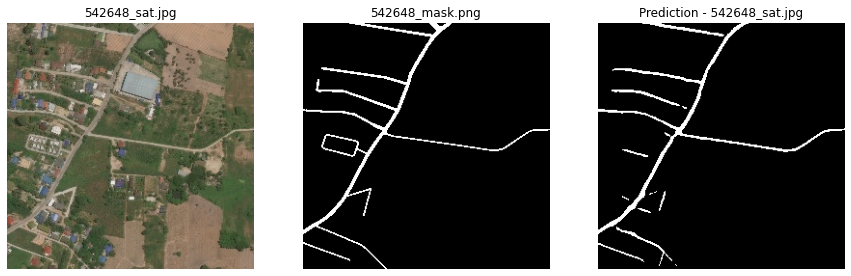

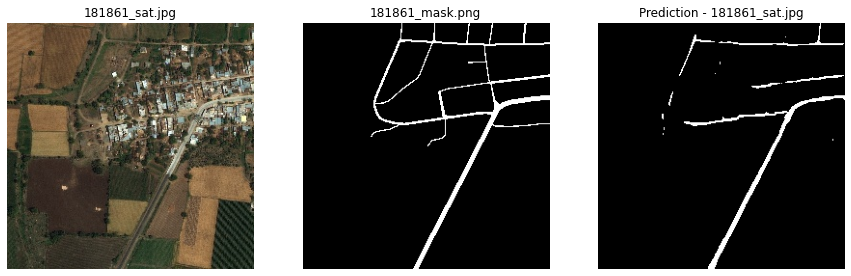

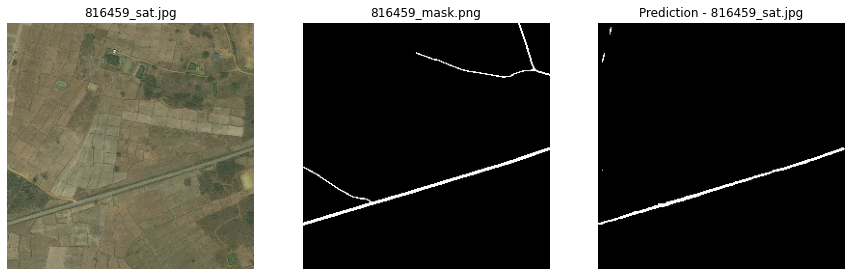

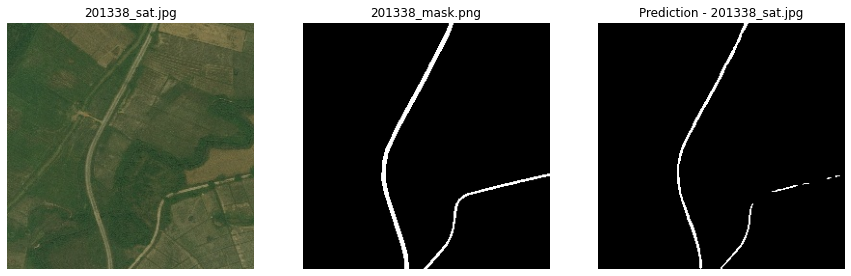

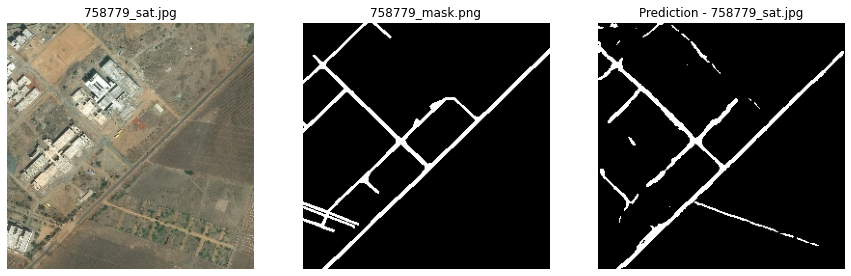

In [58]:
display_patterns_basemodel(data_list=mob_best, model=mobnet_noaug_model)

Medium images - pattern

* In the case of medium images, the model extracted the imcomplete paths.
* The paths that contain large number of bushes on the either side, the model could do extract or do its job well.
* Bushes that are completely levelled up do add value in the whole learning process.

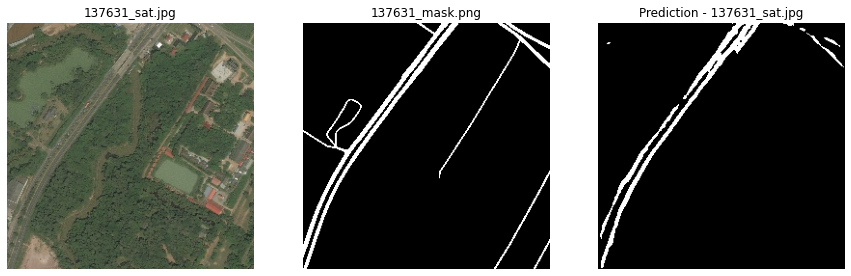

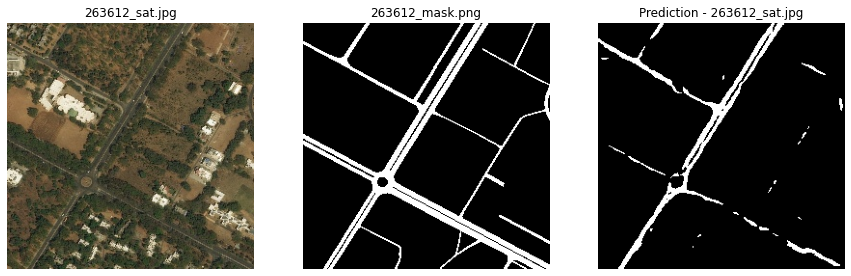

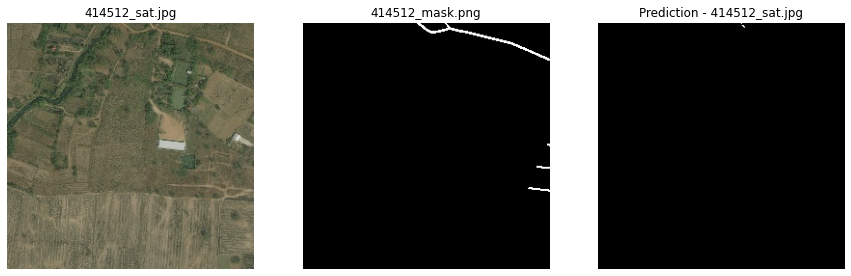

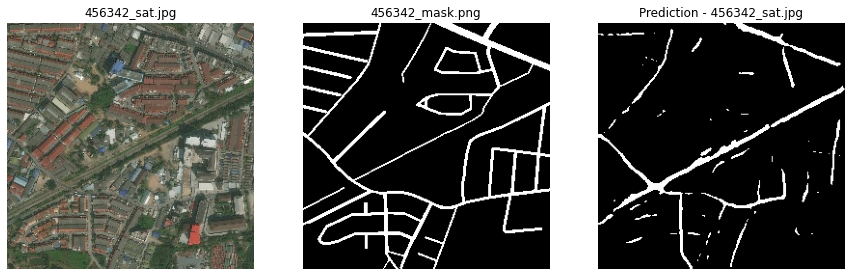

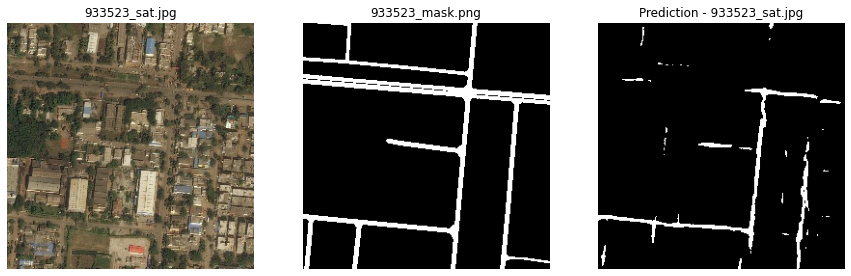

In [59]:
display_patterns_basemodel(data_list=mob_medium, model=mobnet_noaug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [60]:
display_patterns_basemodel(data_list=mob_worst, model=mobnet_noaug_model)

No data available.


#### 6.3.2. Augmentation

In [61]:
mobnet_aug_name = 'mobilenetv2_augmentated'
mobnet_aug_model = get_basemodel(model_name=mobnet_aug_name)
mobnet_aug_sm, mobnet_aug_iou = analyze_basemodel_iou_score(x=sample_data, model=mobnet_aug_model)

In [62]:
print('The IoU for the sample data is : {}'.format(mobnet_aug_iou))

The IoU for the sample data is : 0.11653645286967393


Data segregation

In [63]:
moba_best, moba_medium, moba_worst = segregate_by_iou(mobnet_aug_sm)

Best images - patterns

* In the case of augmented data, the model performed well on those images that contain single larger paths.

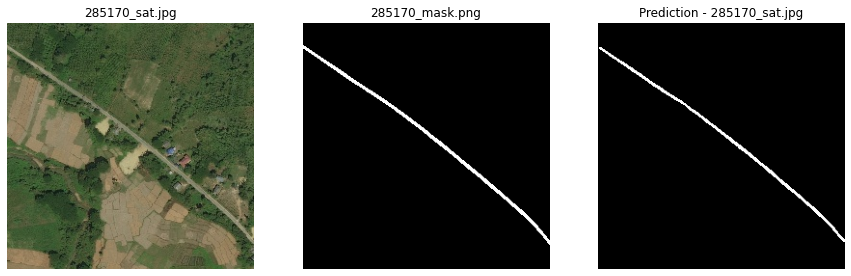

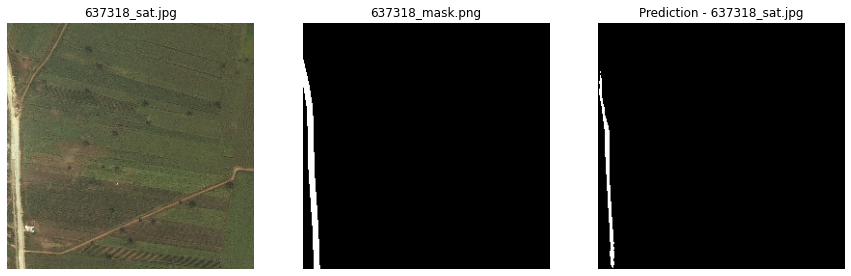

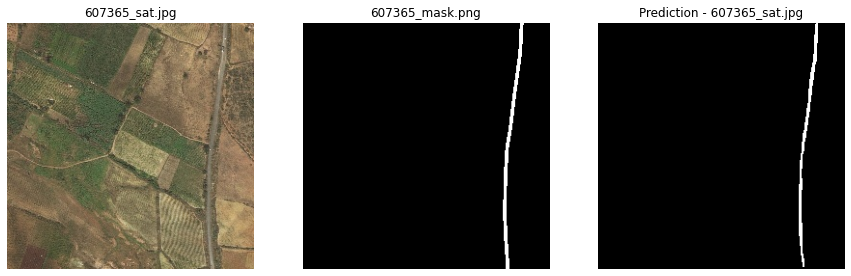

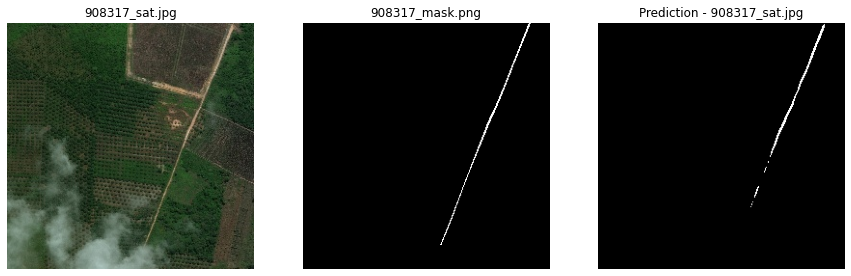

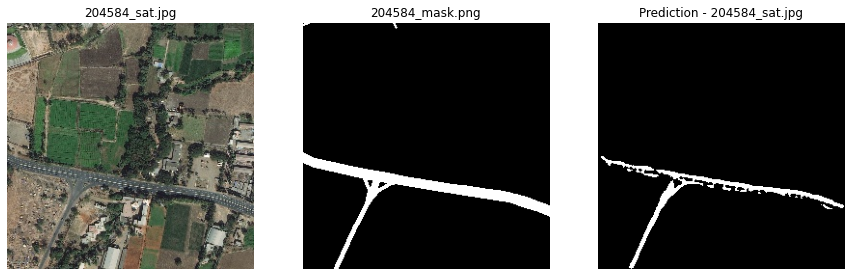

In [64]:
display_patterns_basemodel(data_list=moba_best, model=mobnet_aug_model)

Medium images - pattern

* Images that contain complex textures are not been predicted by the model at its best.
* Less augmentation operations needs to considered to improve it further.

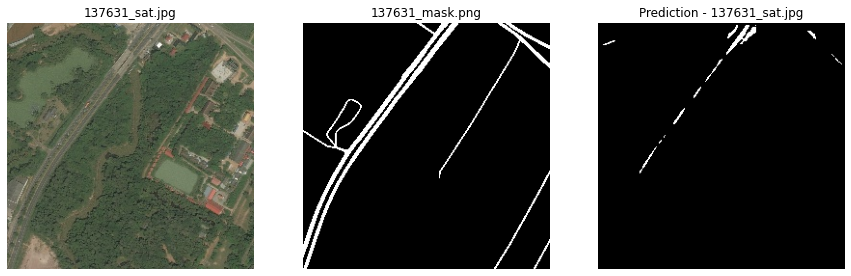

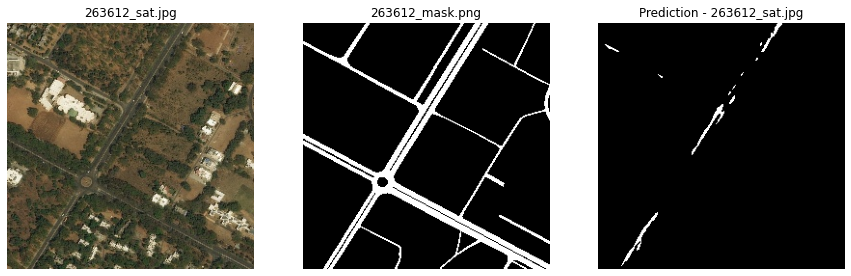

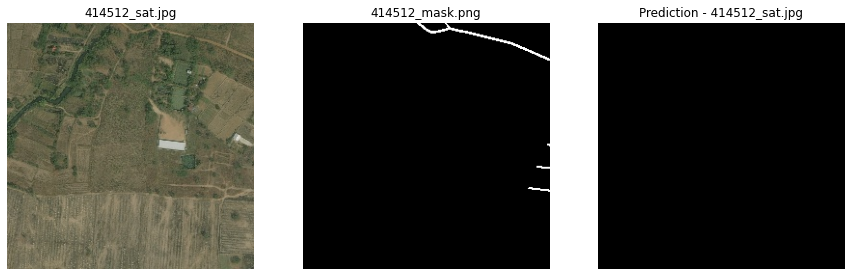

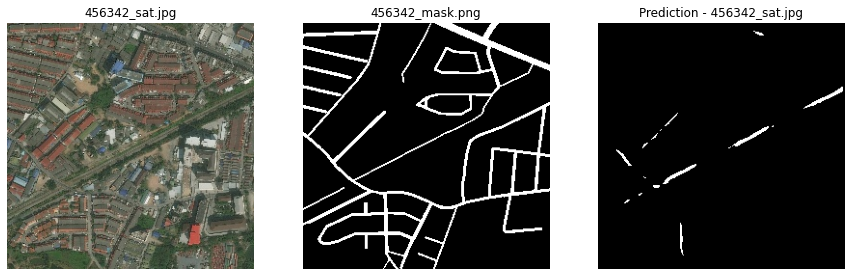

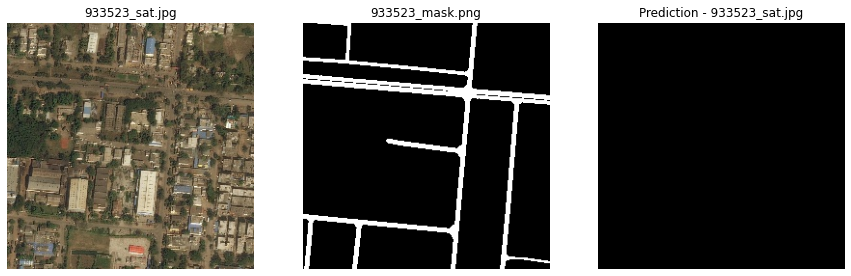

In [65]:
display_patterns_basemodel(data_list=moba_medium, model=mobnet_aug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [66]:
display_patterns_basemodel(data_list=moba_worst, model=mobnet_aug_model)

No data available.


### 6.4. Inception IoU Score

#### 6.4.1. No Augmentation

In [67]:
incept_name = 'inceptionv3'
incept_noaug_model = get_basemodel(model_name=incept_name)
incept_noaug_sm, incept_noaug_iou = analyze_basemodel_iou_score(x=sample_data, model=incept_noaug_model)

In [68]:
print('The IoU for the sample data is : {}'.format(incept_noaug_iou))

The IoU for the sample data is : 0.36578306159779805


Data segregation

In [69]:
in_best, in_medium, in_worst = segregate_by_iou(incept_noaug_sm)

Best images - patterns

* Images that contain larger paths, model can easily find the path of that. But for thinner paths, it is not doing its best.
* There are some patterns of the predictions that exactly match with original mask.
* With some tweaks in the learning rate or extra epochs, it can be fixed.

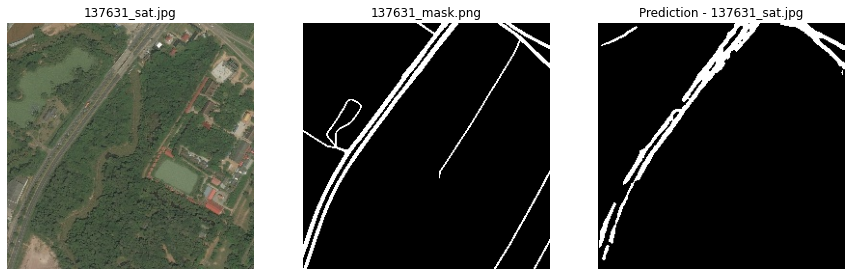

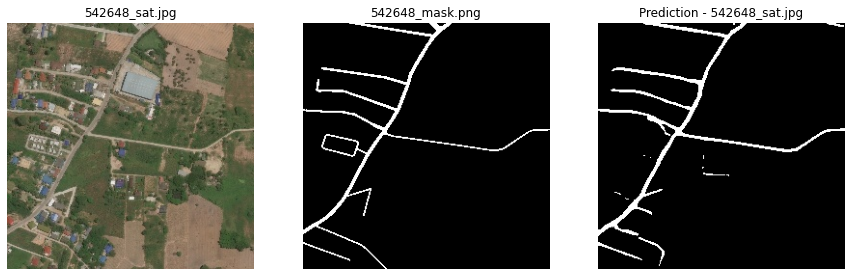

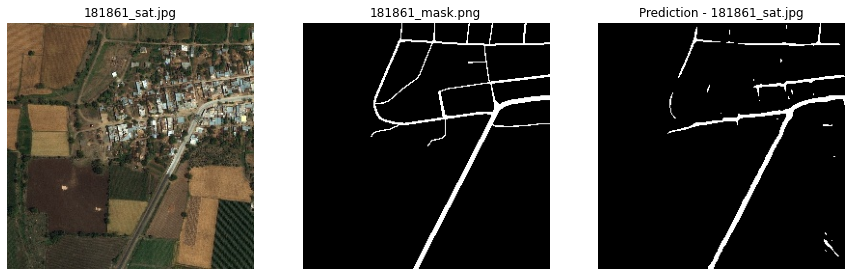

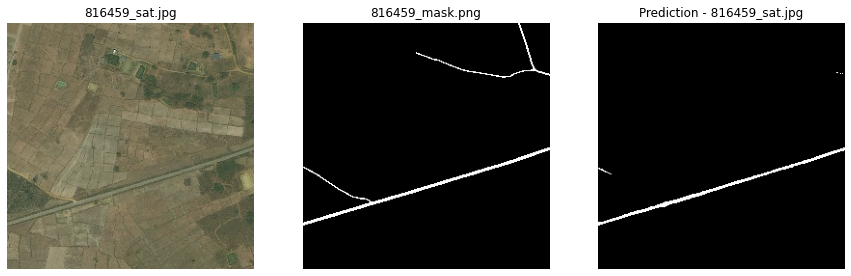

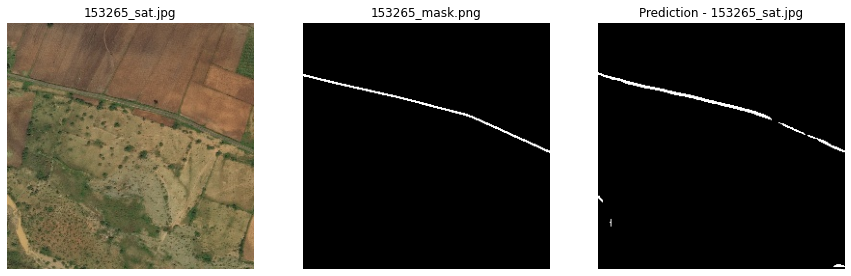

In [70]:
display_patterns_basemodel(data_list=in_best, model=incept_noaug_model)

Medium images - pattern

* In the case of medium images, the model extracted the imcomplete paths.
* The paths that contain large number of bushes on the either side, the model could do extract or do its job well.
* Bushes that are completely levelled up do add value in the whole learning process.

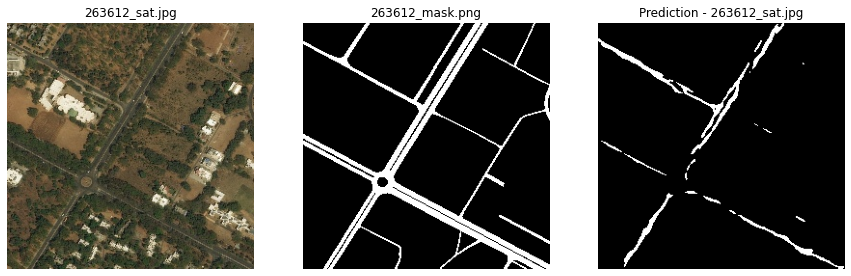

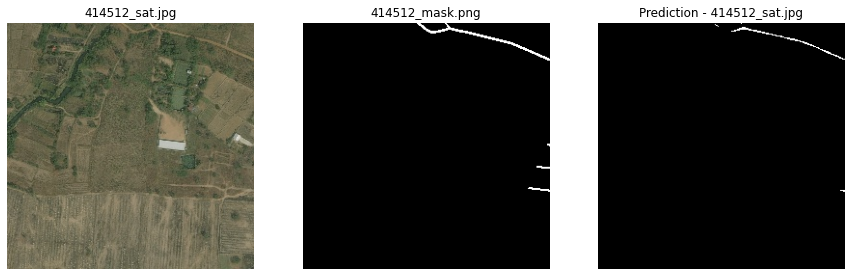

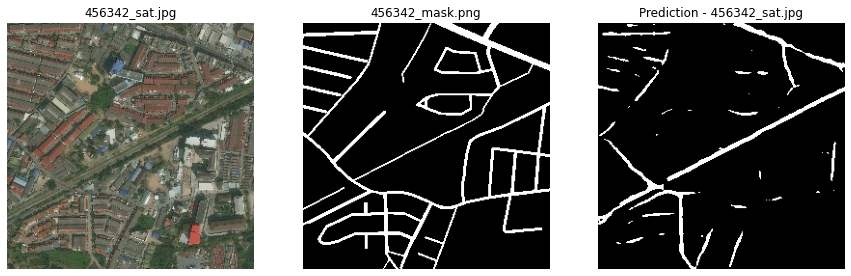

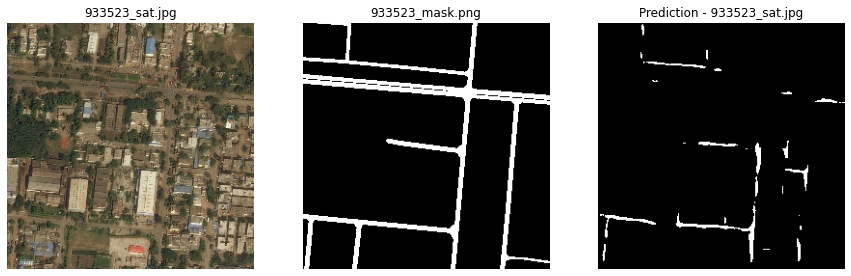

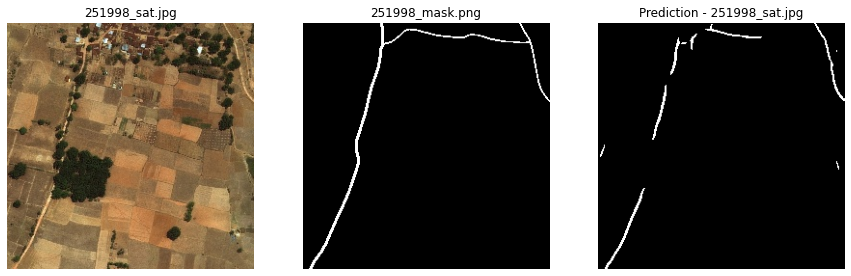

In [71]:
display_patterns_basemodel(data_list=in_medium, model=incept_noaug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [72]:
display_patterns_basemodel(data_list=in_worst, model=incept_noaug_model)

No data available.


#### 6.4.2. Augmentation

In [73]:
incept_aug_name = 'inceptionv3_augmentated'
incept_aug_model = get_basemodel(model_name=incept_aug_name)
incept_aug_sm, incept_aug_iou = analyze_basemodel_iou_score(x=sample_data, model=incept_aug_model)

In [74]:
print('The IoU for the sample data is : {}'.format(incept_aug_iou))

The IoU for the sample data is : 0.07726838701779014


Data segregation

In [75]:
ina_best, ina_medium, ina_worst = segregate_by_iou(incept_aug_sm)

Best images - patterns

* In the case of augmented data, the model performed well on those images that contain single larger paths.

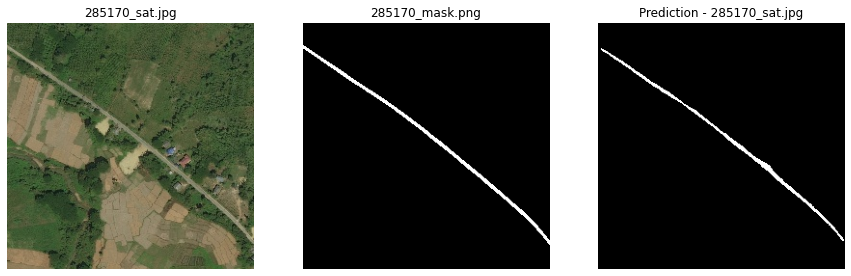

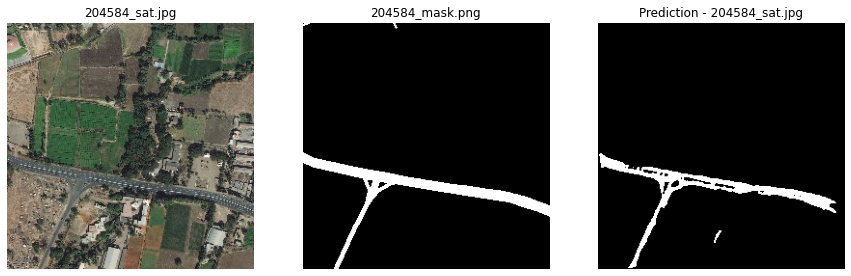

In [76]:
display_patterns_basemodel(data_list=ina_best, model=incept_aug_model)

Medium images - pattern

* Images that contain complex textures are not been predicted by the model at its best.
* Less augmentation operations needs to considered to improve it further.

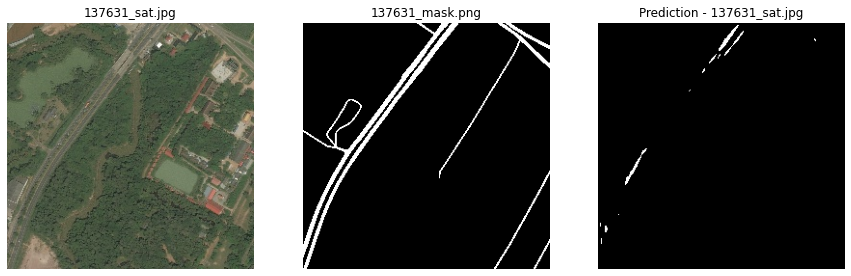

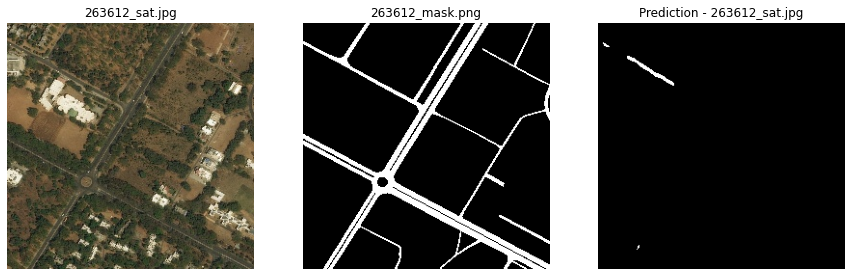

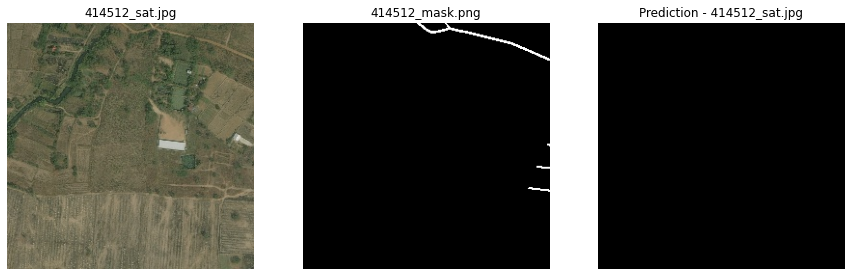

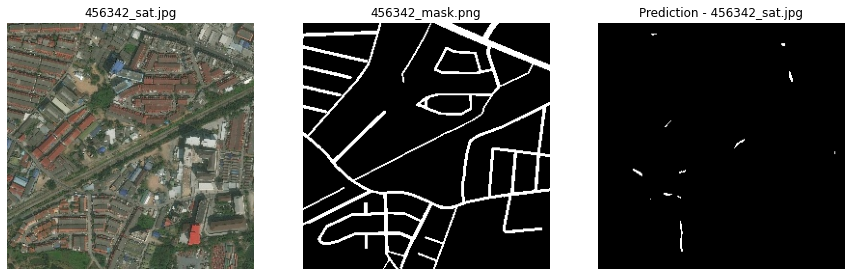

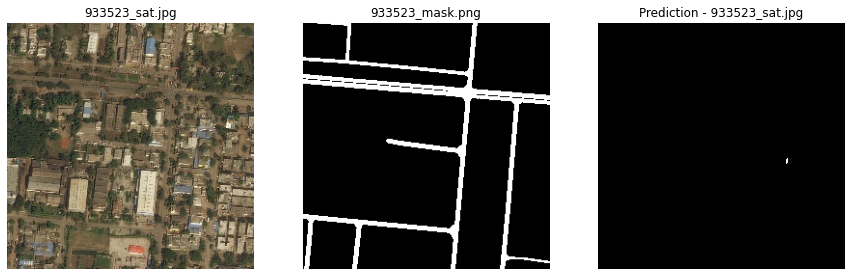

In [77]:
display_patterns_basemodel(data_list=ina_medium, model=incept_aug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [78]:
display_patterns_basemodel(data_list=ina_worst, model=incept_aug_model)

No data available.


### 6.5. ResNet50 IoU Score

#### 6.5.1. No Augmentation

In [79]:
resnet50_name = 'resnet50'
resnet50_noaug_model = get_basemodel(model_name=resnet50_name)
resnet50_noaug_sm, resnet50_noaug_iou = analyze_basemodel_iou_score(x=sample_data, model=resnet50_noaug_model)

In [80]:
print('The IoU for the sample data is : {}'.format(resnet50_noaug_iou))

The IoU for the sample data is : 0.3469163531947146


Data segregation

In [81]:
r50_best, r50_medium, r50_worst = segregate_by_iou(resnet50_noaug_sm)

Best images - patterns

* Images that contain larger paths, model can easily find the path of that. But for thinner paths, it is not doing its best.
* There are some patterns of the predictions that exactly match with original mask.
* With some tweaks in the learning rate or extra epochs, it can be fixed.

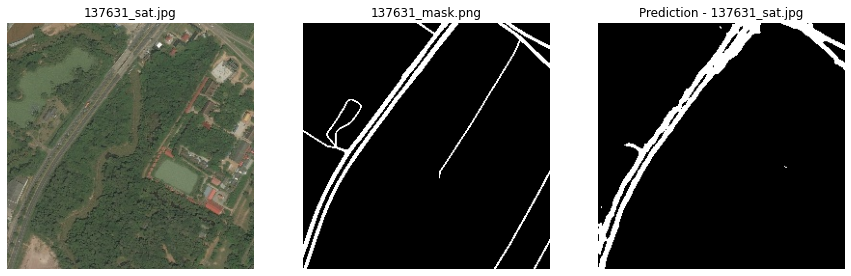

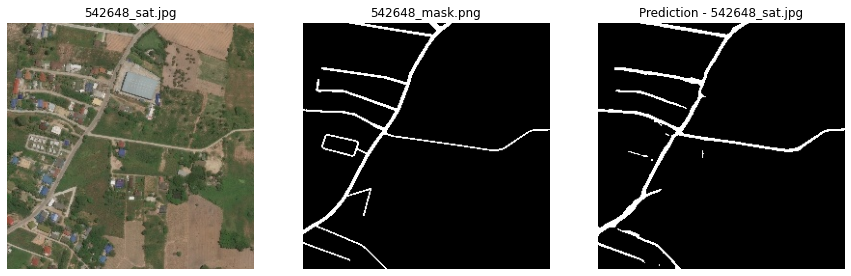

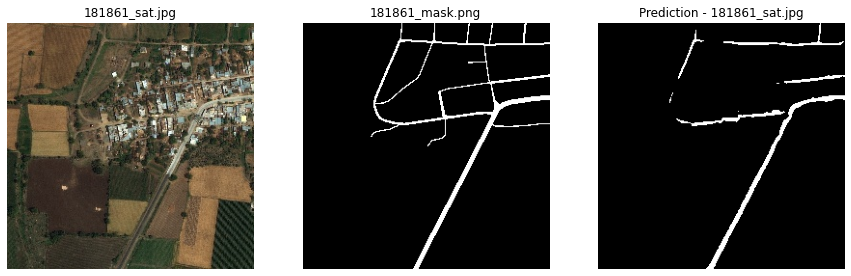

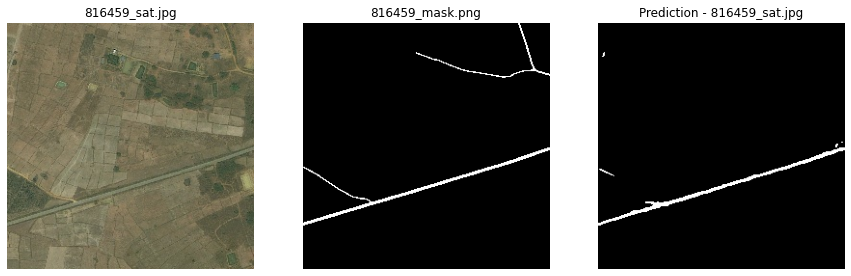

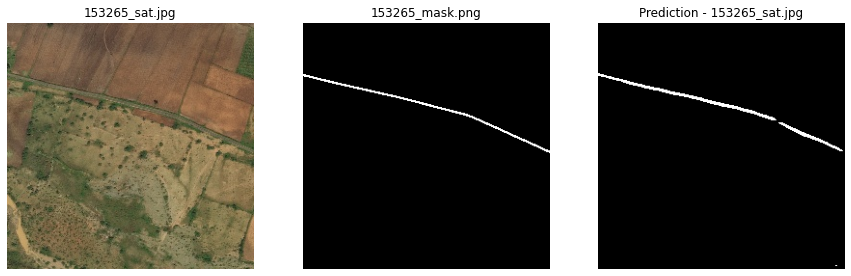

In [82]:
display_patterns_basemodel(data_list=r50_best, model=resnet50_noaug_model)

Medium images - pattern

* In the case of medium images, the model extracted the imcomplete paths.
* The paths that contain large number of bushes on the either side, the model could do extract or do its job well.
* Bushes that are completely levelled up do add value in the whole learning process.

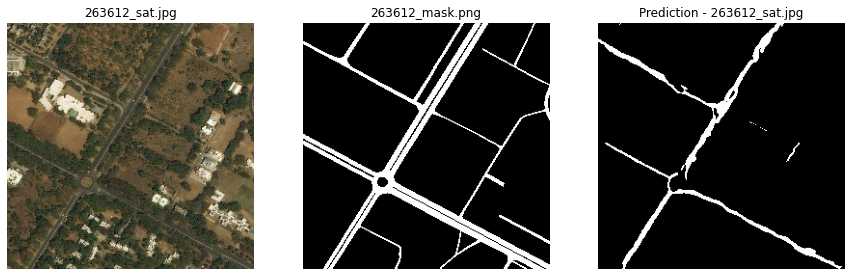

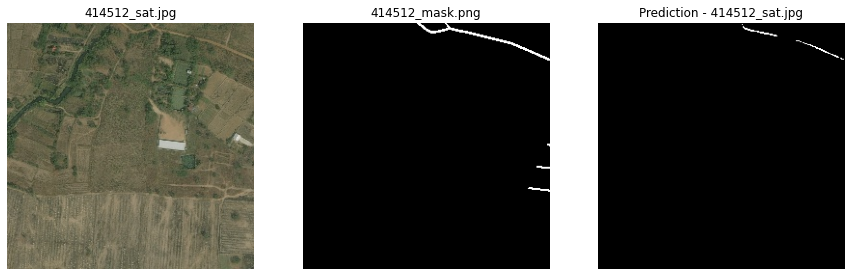

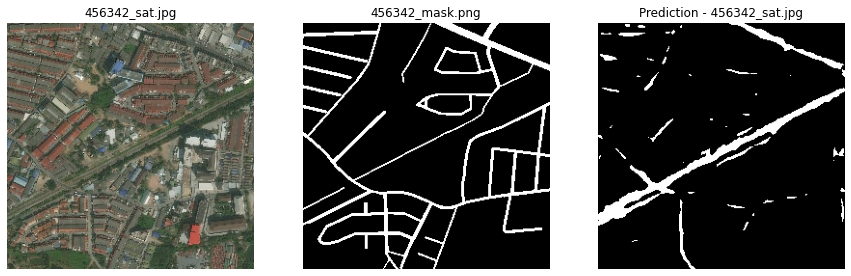

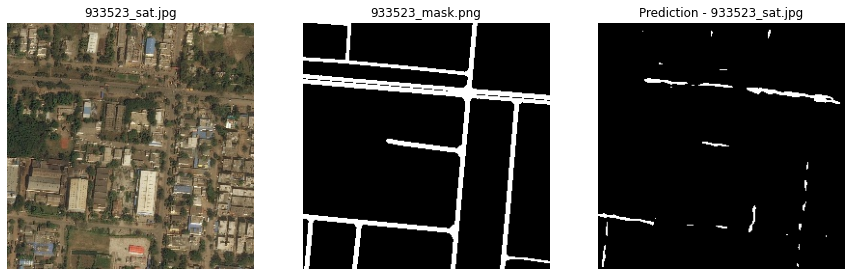

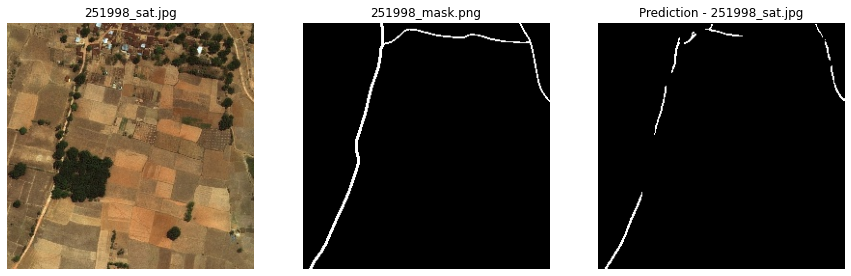

In [83]:
display_patterns_basemodel(data_list=r50_medium, model=resnet50_noaug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [84]:
display_patterns_basemodel(data_list=r50_worst, model=resnet50_noaug_model)

No data available.


#### 6.5.2. Augmentation

In [85]:
resnet50_aug_name = 'resnet50_augmentated'
resnet50_aug_model = get_basemodel(model_name=resnet50_aug_name)
resnet50_aug_sm, resnet50_aug_iou = analyze_basemodel_iou_score(x=sample_data, model=resnet50_aug_model)

In [86]:
print('The IoU for the sample data is : {}'.format(resnet50_aug_iou))

The IoU for the sample data is : 0.0365444542586975


Data segregation

In [87]:
r50a_best, r50a_medium, r50a_worst = segregate_by_iou(resnet50_aug_sm)

Best images - patterns

* There are no images whose `IoU` is above 0.5. This is not good.
* The performance-wise, it is not as good as resnet34.

In [88]:
display_patterns_basemodel(data_list=r50a_best, model=resnet50_aug_model)

No data available.


Medium images - pattern

* Images that contain complex textures are not been predicted by the model at its best.
* Less augmentation operations needs to considered to improve it further.

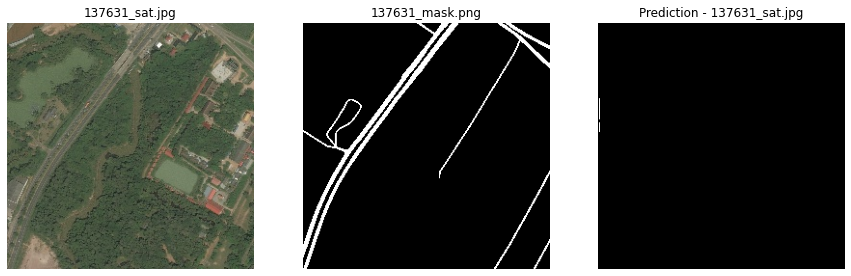

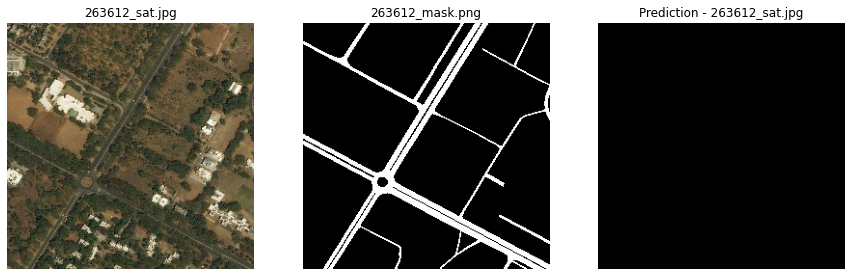

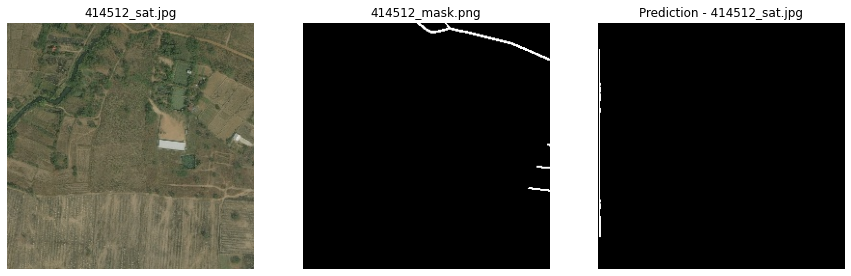

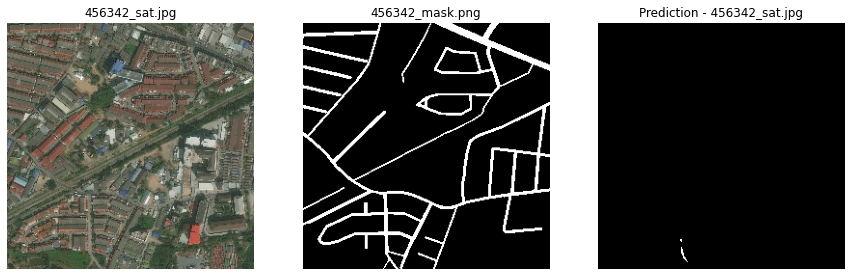

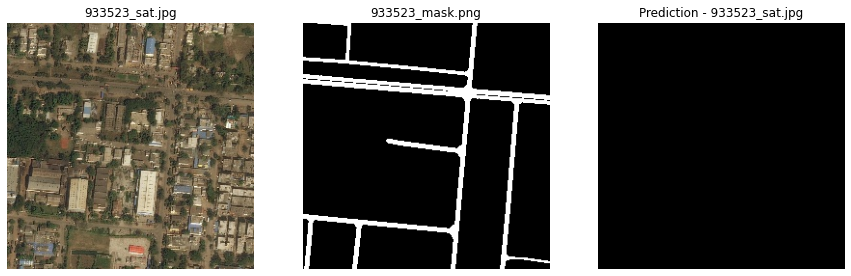

In [89]:
display_patterns_basemodel(data_list=r50a_medium, model=resnet50_aug_model)

Worst images - patterns

* Fortunately, there are no images whose `IoU` is less than 0.25.

In [90]:
display_patterns_basemodel(data_list=r50a_worst, model=resnet50_aug_model)

No data available.


## 7. Summary

In [91]:
from tabulate import tabulate

In [92]:
no_aug_model_names = [unet_scratch_name, resnet34_name, vgg16_name, mobnet_name, incept_name, resnet50_name]
no_aug_iou_scores = [unet_noaug_iou, resnet34_noaug_iou, vgg16_noaug_iou, mobnet_noaug_iou, incept_noaug_iou, resnet50_noaug_iou]
aug_model_names = [unet_scratch_aug_name, resnet34_aug_name, vgg16_aug_name, mobnet_aug_name, incept_aug_name, resnet50_aug_name]
aug_iou_scores = [unet_aug_iou, resnet34_aug_iou, vgg16_aug_iou, mobnet_aug_iou, incept_aug_iou, resnet50_aug_iou]

summ_df = pd.DataFrame()
summ_df['No Aug Models'] = no_aug_model_names
summ_df['No Aug IoUs'] = no_aug_iou_scores
summ_df['Aug Models'] = aug_model_names
summ_df['Aug IoUs'] = aug_iou_scores

summary = tabulate(tabular_data=summ_df, headers='keys', tablefmt='psql')
print(summary)

+----+-----------------+---------------+--------------------------+------------+
|    | No Aug Models   |   No Aug IoUs | Aug Models               |   Aug IoUs |
|----+-----------------+---------------+--------------------------+------------|
|  0 | unet_scratch    |      0.512638 | unet_scratch_augmentated |  0.482702  |
|  1 | resnet34        |      0.344452 | resnet34_augmentated     |  0.0857029 |
|  2 | vgg16           |      0.369206 | vgg16_augmentated        |  0.0521435 |
|  3 | mobilenetv2     |      0.378071 | mobilenetv2_augmentated  |  0.116536  |
|  4 | inceptionv3     |      0.365783 | inceptionv3_augmentated  |  0.0772684 |
|  5 | resnet50        |      0.346916 | resnet50_augmentated     |  0.0365445 |
+----+-----------------+---------------+--------------------------+------------+


* I took a sample of `100` images to get the `IoU` scores.
* The best model from the above summary table is `U-Net` model (not trained on augmented data).
    - If I had considered a larger sample, it would have been more than `0.51`.
* The above table shows everything what we want. We can observe that the models do not perform well on augmented data.
    - The reason can be that, the training data is large and if performed augmentation upon that, it may tend to perform worse.